# QuickGuide for Text analysis
[프로젝트 페이지: Research-on-the-TV-market](https://github.com/xikest/research-market-tv)

## Env setting

In [2]:
!pip install -U pandas tqdm wget --q
!pip install -U PyMuPDF pytube --q
!pip install -U wordcloud nltk --q
!pip install -U matplotlib seaborn --q
!pip install -U opencv-python --q
!pip install -U mkt-retv --q

## Package Import 

In [1]:
from market_research.analysis import TextAnalysis
import nltk
from market_research.ir import SONY_IR
# nltk.download('punkt')
# nltk.download('punkt_tab')
# nltk.download('stopwords')
# nltk.download('averaged_perceptron_tagger')
# nltk.download('averaged_perceptron_tagger_eng')

## Text 분석

In [3]:
tas = TextAnalysis()
ir_class = SONY_IR()

### SONY group Q&A Summary (Earnings Releases) 2019~2023
https://www.sony.com/en/SonyInfo/IR/library/presen/er/archive.html

#### visualization: wordcloud, freq

Error downloading https://www.sony.com/en/SonyInfo/IR/library/presen/er/pdf/24q2_qa.pdf: HTTP Error 404: Not Found
Error downloading https://www.sony.com/en/SonyInfo/IR/library/presen/er/pdf/24q3_qa.pdf: HTTP Error 404: Not Found
Error downloading https://www.sony.com/en/SonyInfo/IR/library/presen/er/pdf/24q4_qa.pdf: HTTP Error 404: Not Found
downloaded in 'C:\content\input'


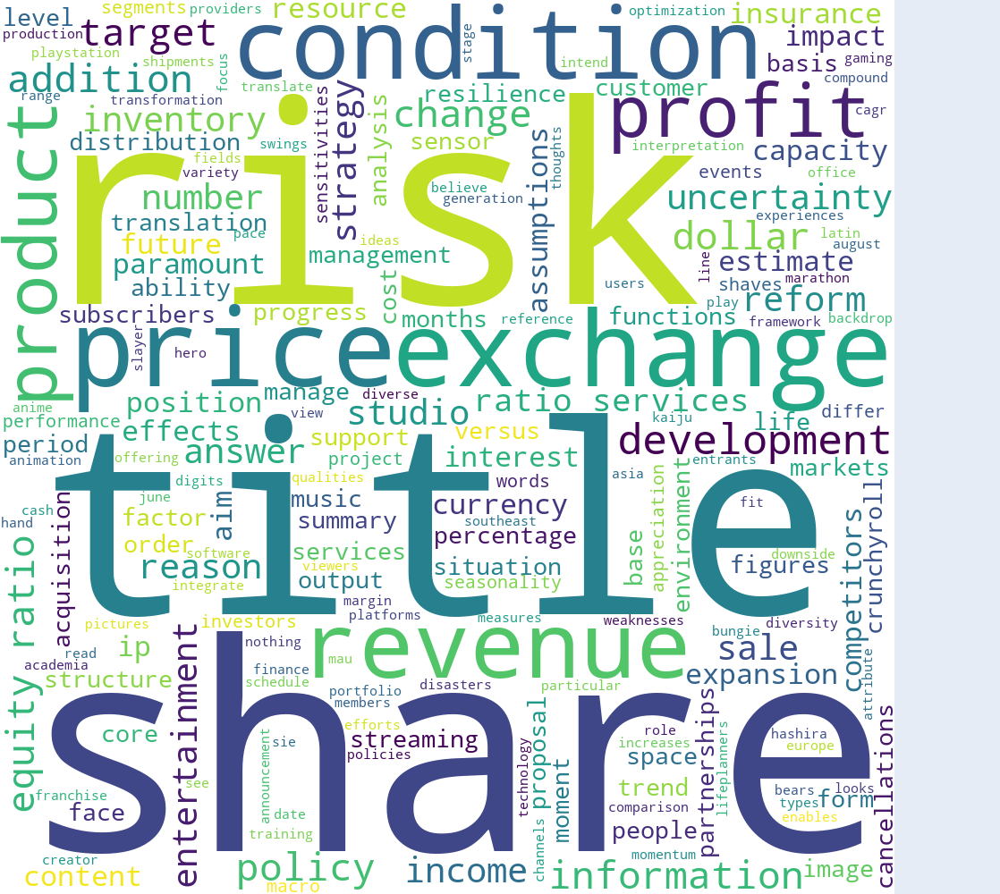

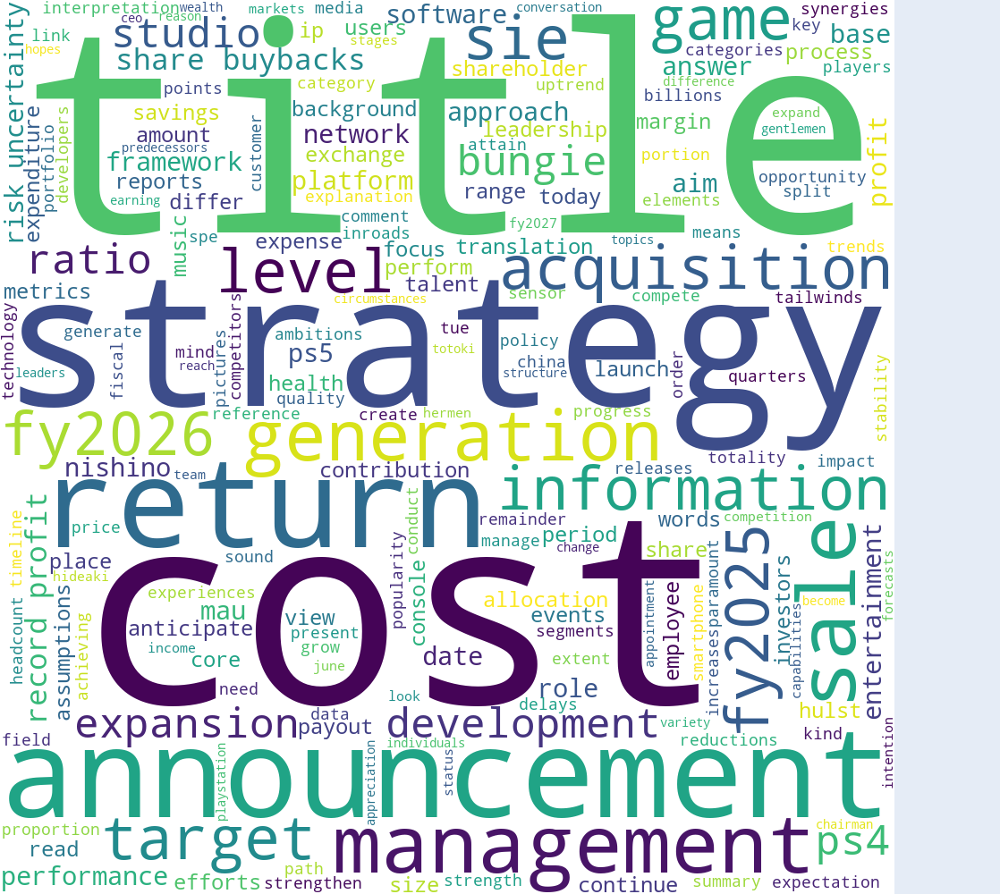

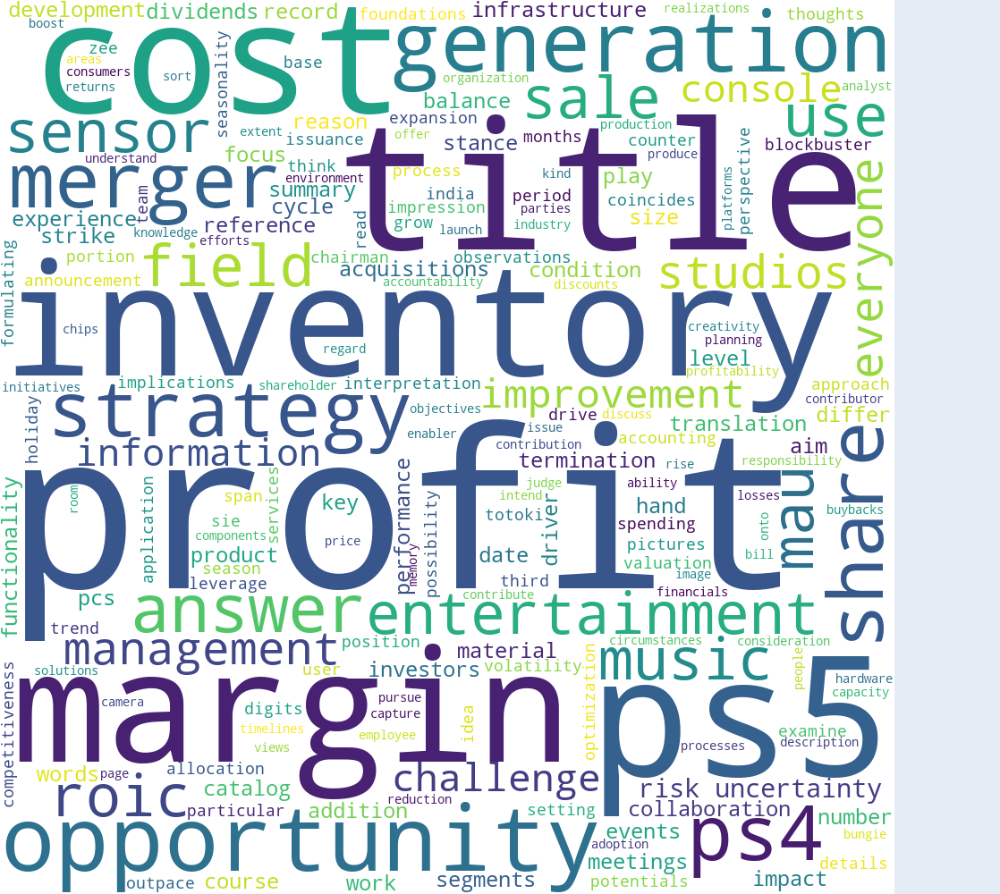

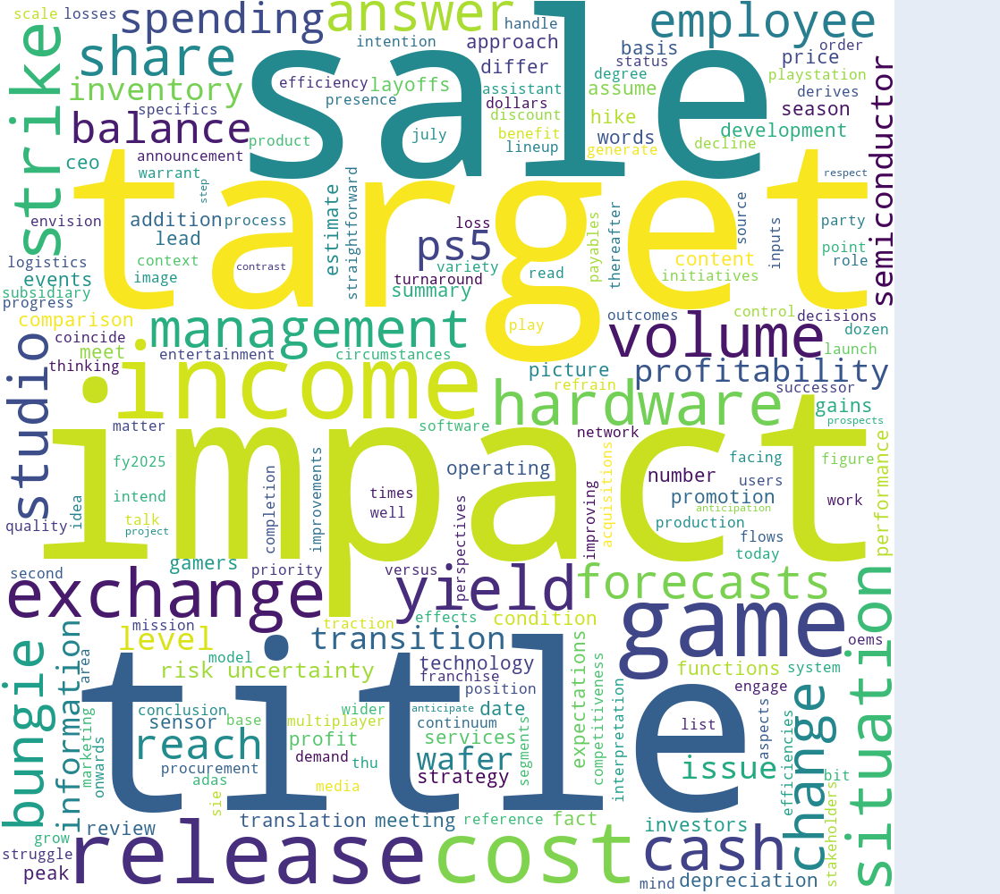

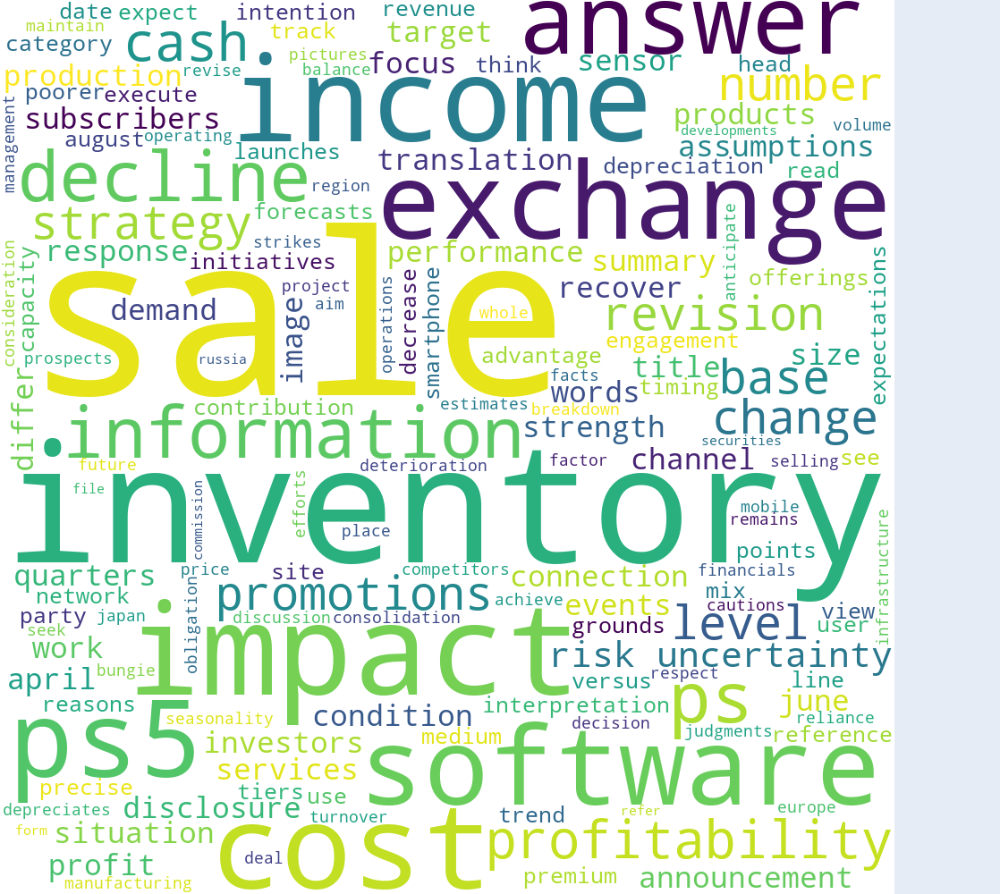

...

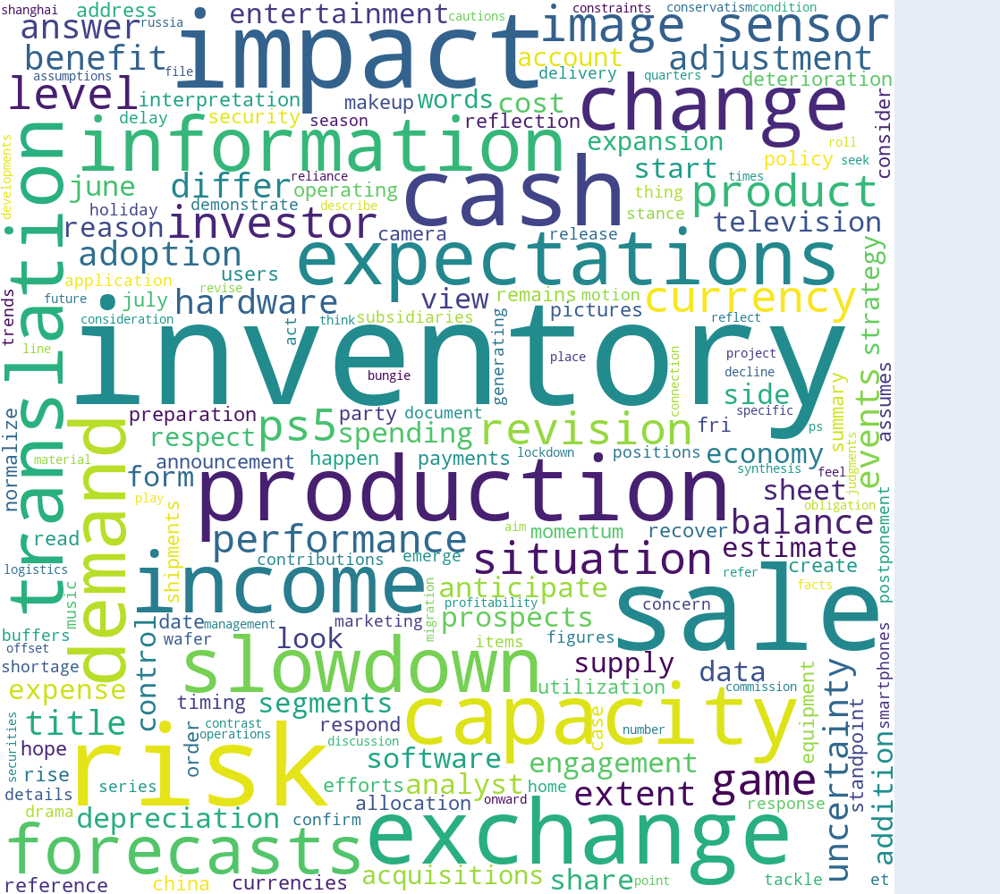

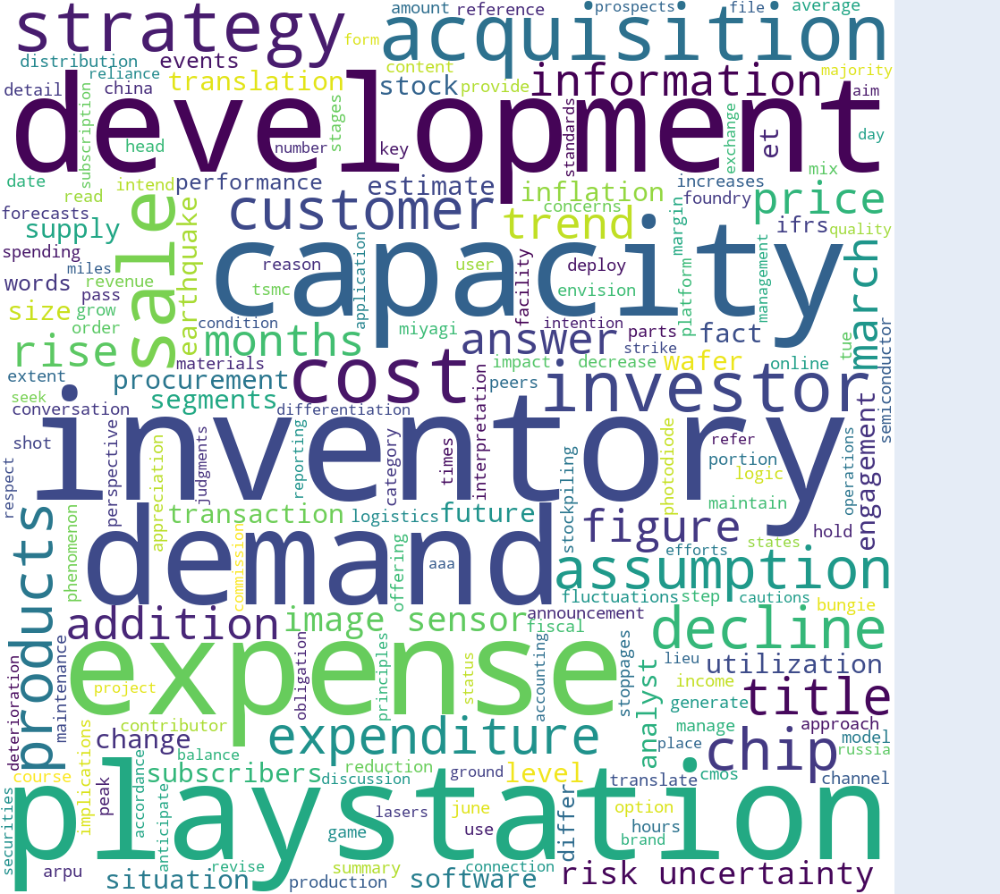

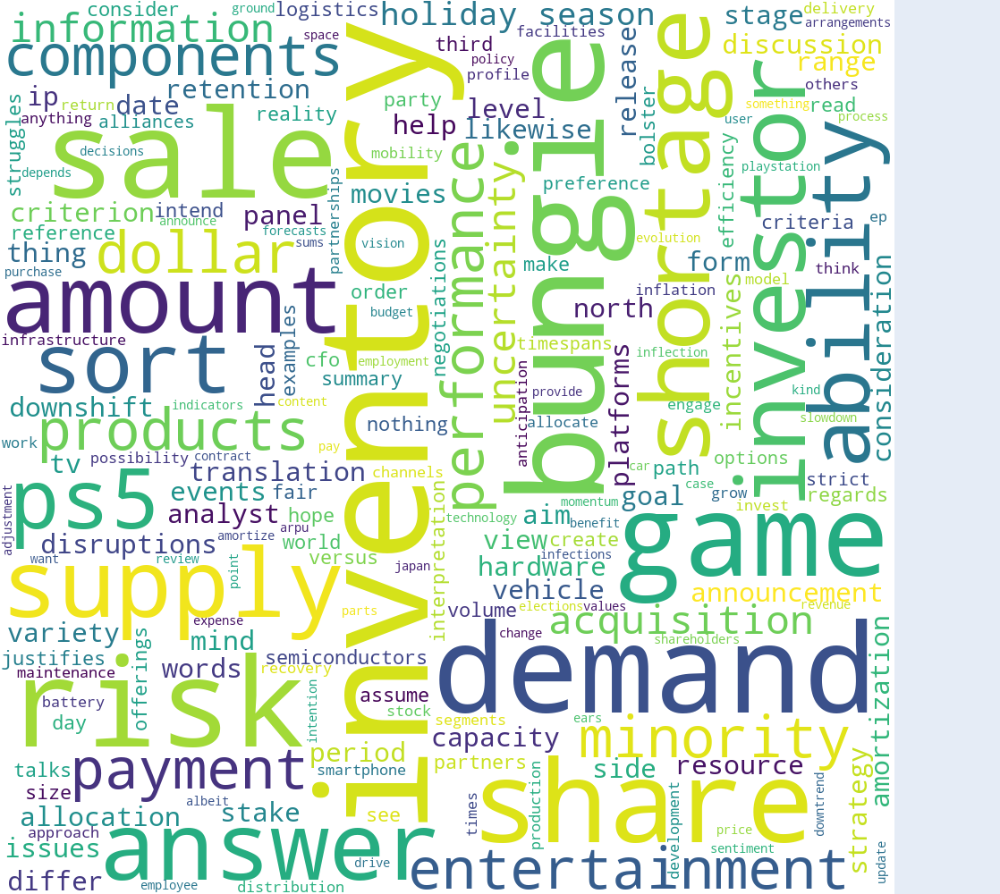

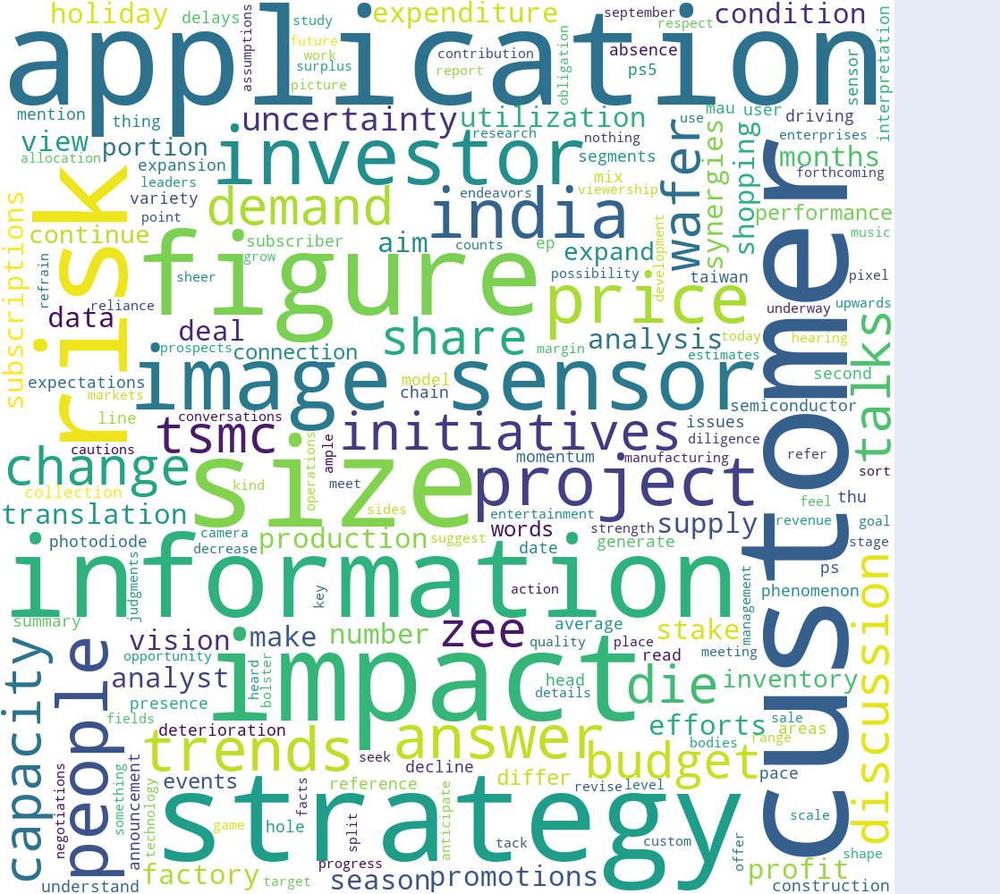

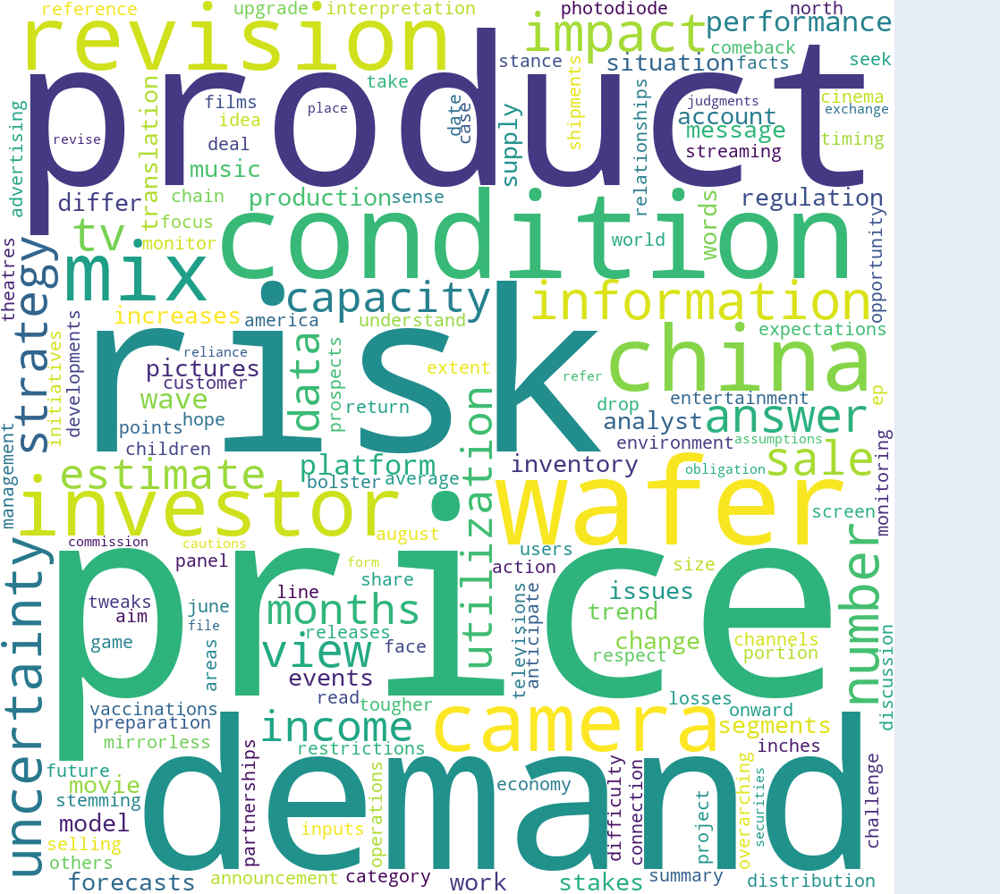

In [ ]:
comments_dict, files_path_dict = ir_class.get_ir_script()
cleaning_words = ir_class.cleaning_words
comment_keys = sorted(list(comments_dict.keys()), reverse=True)
for selected_comment_key in comment_keys:
    selected_comment_text = comments_dict[selected_comment_key]
    fig = tas.plot_wordcloud(selected_comment_text, cleaning_words)
    fig.show()

In [34]:
summary_dict = {}

for filename, comment in comments_dict.items():
    print(f"\n■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ {filename} ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■\n")
    # summary = sentgpt.analyze_sentiment(assistant=assistant, sentence= comments_dict.get(filename))
    print(comment)
    # summary_dict[filename] = summary


■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ 19q1_qa ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■

fy2019 q1 earnings announcement 
analyst and investor briefing q&a (summary) 
 
date: july 30, 2019 (tue) 
 
important: please read the following statement 
for your reference, below please find an english translation of the question and answer session at 
the analyst and investor briefing for the financial results for the first quarter ended june 30, 2019, 
which was conducted in japanese (except for questions asked in english).     
 
this transcript has been edited for the sake of clarity.  footnotes have been included to correct any 
inaccurate statements. 
 
as a result, there are some differences between the english translation of the transcript below and 
the simultaneous english interpretation provided at the actual question and answer session.  a 
recording of the simultaneous english interpretation can be found on the sony investor relation

### SONY group Q&A Summary (Corporate Strategy Meeting) 2021~2023
https://www.sony.com/en/SonyInfo/IR/library/presen/strategy/archive.html

In [ ]:
base_url = "https://www.sony.com/en/SonyInfo/IR/library/presen/strategy/pdf"
years = range(2020, 2024)
urls = []
for year in years:
    for quarter in quarters:
        url = f"{base_url}/{year}/qa_E.pdf"
        urls.append(url)

tas.download_pdfs(urls)

In [9]:
files_path = tas.read_files_from_inputpath(docs_type="pdf")
files_path # SONY group earing call QnA 2019~2023

[WindowsPath('input/qa_E_2020_May_19.pdf'),
 WindowsPath('input/qa_E_2021_May_26.pdf'),
 WindowsPath('input/qa_E_2022_May_18.pdf'),
 WindowsPath('input/qa_E_2023_May_18.pdf')]

#### 필터링 단어 설정

In [27]:
cleaning_words = [  #사전 필터링하는 단
    "half","fy2021","fy2020", "month","way", "input","earnings",
    "forecast","please","terms","market","g","ns", "unit","assets",
    "fy2022","levels","q","fy2023","numbers","result","units",
    "factors","costs","ss","q1","part",'segment', 'quarter', 
    'statements', 'business', 'question', 'yen', 'year', 'sony', 'results',
    "end","q2","questioner",
    "session","fy2024",
    # "sale","plan","capacity","growth","demand",
    "outlook","increase","investment",
    "example","rate","flow","time","a2","a1","sfh","r","dtc", "statement",
    "plan", "tax", "value", "term","capital", "growth","company","group", "service",
    "risk","profit","minotrity"
]



#### 단어 교정

In [ ]:
replacement_mapping = {  #사전에 교체하는 단어
    "games": "game",
    "plans": "plan",
    "sensors": "sensor",
    "changes": "change",
    "risks": "risk",
    "services": "service",
    "margins": "margin",
    "profits": "profit",
    "wafers": "wafer",
    "sizes": "size",
    "customers": "customer",
    "applications": "application",
    "shortages": "shortage",
    "expenses": "expense",
    "sales":"sale",
    "titles":"title",
    "conditions":"condition",
    "prices":"price",
    "investments":"investment",
    "rates":"rate",
    "inventories":"inventory",
    "uncertainties":"uncertainty",
    "cameras":"camera",
    "opportunities":"opportunity",
    "volumes":"volume",
    "costs":"cost",
    "technologies":"technology",
    "employees":"employee",
    "companies":"company",
    "creators":"creator",
    "challenges":"challenge",
    "businesses":"business",
    "years":"year",
    "electronics":"electronic",
    "strategies":"strategy",
    "electronics":"electronic",
    "targets":"target",
    "statements":"statement"
}

#### visualization: wordcloud, freq


■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ qa_E_2020_May_19 ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■

top 5 words before cleaning: 
          Nouns  Frequency
23    business         20
6    statement         11
24       group         10
22        sony         10
109       plan          8


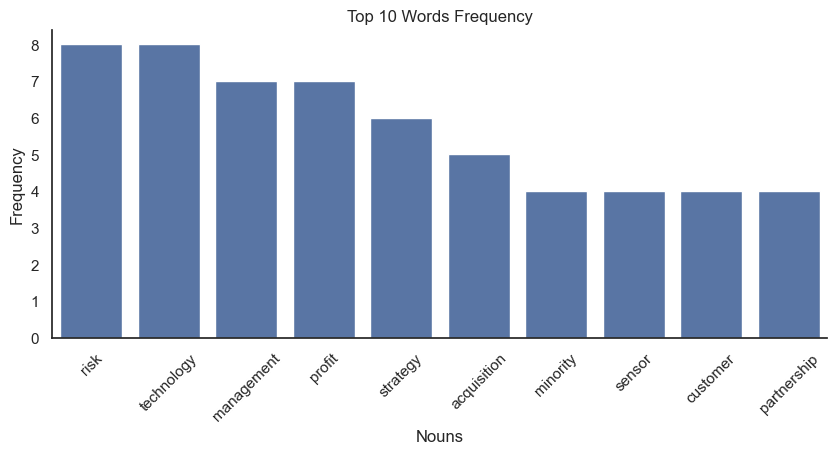

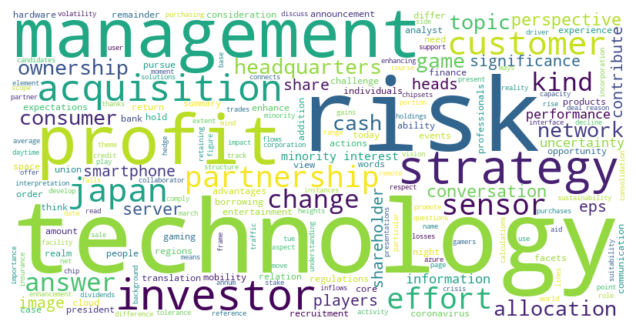


■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ qa_E_2021_May_26 ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■

top 5 words before cleaning: 
           Nouns  Frequency
200  technology         16
5     statement         11
38         sony         11
85     business          9
81      company          9


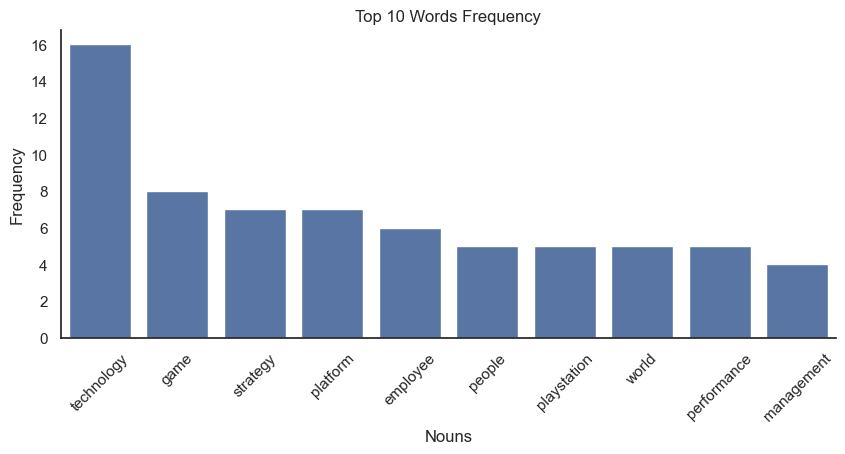

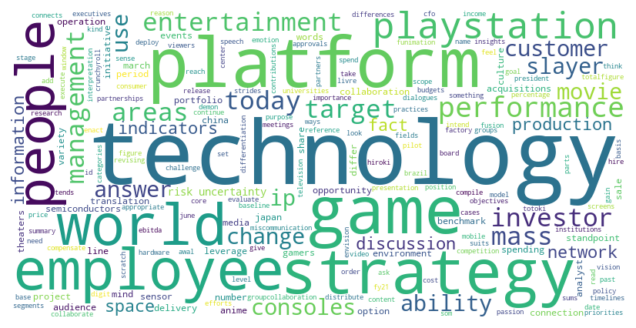


■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ qa_E_2022_May_18 ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■

top 5 words before cleaning: 
           Nouns  Frequency
80     business         21
115  investment         15
5     statement         13
28         sony         11
21         game         10


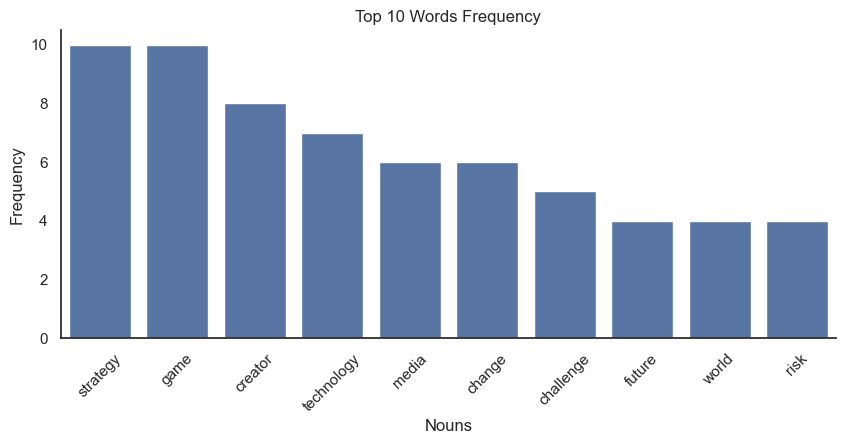

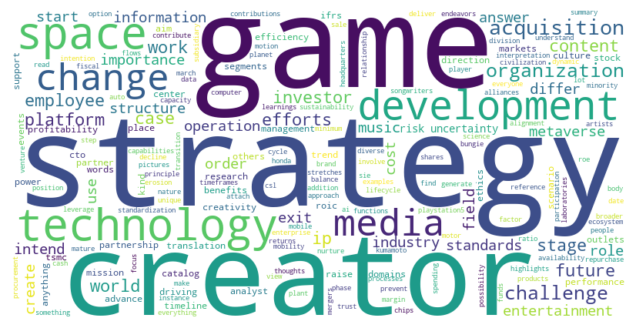


■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ qa_E_2023_May_18 ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■

top 5 words before cleaning: 
         Nouns  Frequency
19   business         62
10       year         19
39     growth         18
107      plan         17
43       sony         16


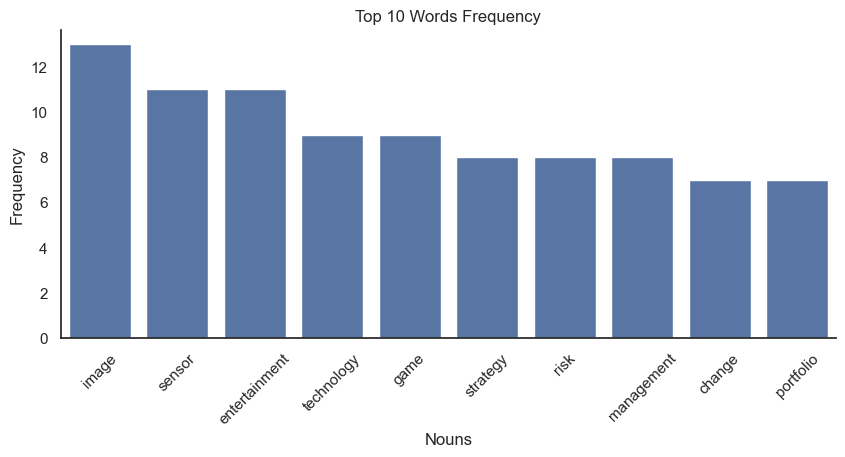

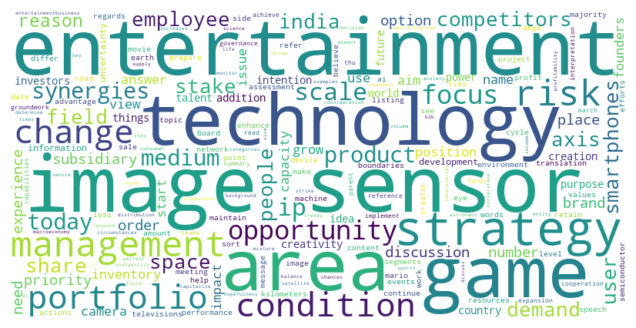

In [28]:
comments_dict = {file_path.name.replace(".pdf",""):tas.pdf_to_text(file_path) for file_path in files_path}
for filename, comment in comments_dict.items():
    print(f"\n■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■ {filename} ■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■■\n")
    for original, replacement in replacement_mapping.items():  #복수형 단수로 변경
        comment = comment.replace(original, replacement)
        
    tas.set_comments([comment], [])
    print(f"top 5 words before cleaning: \n {tas.df_word_freq.sort_values(by='Frequency', ascending=False).head(5)}")

    tas.set_comments([comment], cleaning_words)
    tas.plot_freq()
    tas.plot_wordcloud()

## colab에서 파일 받기

In [ ]:
# from google.colab import files
# !zip -r /content/results_text.zip /content/results_text/
# files.download('/content/results_text.zip')

---